<a href="https://colab.research.google.com/github/seregichevks/time_series/blob/main/for_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# https://sibur.ai-community.com/competitions/1 Задача: Закоксованность катализатора

In [ ]:
!pip install tsfresh

In [1]:
# импортируем необходимые библиотеки
import numpy as np
import pandas as pd
import altair as alt
import missingno as msno
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn import linear_model
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_predict, cross_val_score, TimeSeriesSplit
from itertools import product
from tqdm import tqdm_notebook
from tsfresh.examples.har_dataset import download_har_dataset, load_har_dataset, load_har_classes
from tsfresh import extract_features, extract_relevant_features, select_features
from tsfresh.utilities.dataframe_functions import impute
from tsfresh.feature_extraction import settings
from statsmodels.tsa.statespace.sarimax import SARIMAX
import statsmodels.formula.api as smf            # statistics and econometrics
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs
import warnings 

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [2]:
# MAPE
def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
def tsplot(y, lags=None, figsize=(12, 7), style='bmh'):
    """
        Plot time series, its ACF and PACF, calculate Dickey–Fuller test
        
        y - timeseries
        lags - how many lags to include in ACF, PACF calculation
    """
    
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
        
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        layout = (2, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        
        y.plot(ax=ts_ax)
        p_value = sm.tsa.stattools.adfuller(y)[1]
        ts_ax.set_title('Time Series Analysis Plots\n Dickey-Fuller: p={0:.5f}'.format(p_value))
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax)
        plt.tight_layout()

In [ ]:
# загрузим данные сенсоров
data_x = pd.read_csv('sensors.csv', parse_dates=['timestamp'])

# и посмотрим их
data_x.head(3)

,timestamp,f_0,f_1,f_2,f_3,f_4,f_5,f_6,f_7,f_8,f_9,f_10,f_11,f_12,f_13,f_14,f_15,f_16,f_17,f_18,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30,f_31,f_32,f_33,f_34,f_35,f_36,f_37,f_38,f_39,f_40,f_41,f_42,f_43,f_44,f_45,f_46,f_47
0,2016-10-24 16:00:00,NaN,NaN,NaN,-0.005383,6.251910,0.022304,1.466704,11.173872,236232.328494,239141.739468,236047.718208,10388.134152,10301.147575,10514.105249,45.330807,114.308237,130.949307,41.057286,105.973865,129.767924,643.938028,641.805951,37.864843,105.766633,131.088479,647.015112,33.219880,105.078138,629.911638,630.898807,620.607633,641.471009,119.665939,9.468025,8.720790,9.491729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10518.438958,235581.702442,10271.912950,1.718926,64589.460605
1,2016-10-24 17:00:00,NaN,NaN,NaN,0.103383,6.465077,0.011693,1.267009,12.987551,236736.358537,237598.686177,234667.198152,10342.275453,10243.497056,10522.399442,45.346491,113.573405,131.134979,40.879320,106.376817,131.056496,645.646962,644.467521,37.998703,107.147223,131.258352,646.445612,32.923039,108.432319,630.888662,631.148243,617.627299,649.892132,120.168816,9.492814,8.672949,9.442881,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10529.380416,236303.564486,10185.329909,18.454216,64736.370856
2,2016-10-24 18:00:00,NaN,NaN,NaN,-0.004852,6.315273,-0.003072,1.216848,12.824779,235780.400580,238313.969270,236595.519278,10311.392170,10295.566635,10545.026172,42.496189,113.960934,130.360285,40.834278,105.843890,130.375261,644.225458,643.544517,37.934885,107.696556,130.797973,647.069870,33.152057,106.901200,626.594563,631.062718,618.326995,636.883422,120.237631,9.501467,8.754266,9.406755,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10472.545087,237051.461382,10149.728277,5.764785,64638.208960


In [ ]:
# тоже самое с целевой перменной
data_y = pd.read_csv('coke_target.csv', parse_dates=['timestamp'])

data_y.head(10)

,timestamp,target
0,2016-10-24 16:00:00,2.714220
1,2016-10-24 17:00:00,2.709524
2,2016-10-24 18:00:00,2.709705
3,2016-10-24 19:00:00,2.715567
4,2016-10-24 20:00:00,2.706246
5,2016-10-24 21:00:00,2.713263
6,2016-10-24 22:00:00,2.703611
7,2016-10-24 23:00:00,2.697621
8,2016-10-25 00:00:00,2.701750
9,2016-10-25 01:00:00,2.695615


In [ ]:
# загрузим целевую переменную для обработки с помощью SARIMA
target = pd.read_csv('coke_target.csv', index_col=['timestamp'], parse_dates=['timestamp'])
target = target.resample('1D').median() # переиндексация в случае большой выборки
target

,target
timestamp,
2016-10-24 16:00:00,2.714220
2016-10-24 17:00:00,2.709524
2016-10-24 18:00:00,2.709705
2016-10-24 19:00:00,2.715567
2016-10-24 20:00:00,2.706246
...,...
2017-12-31 19:00:00,3.281670
2017-12-31 20:00:00,3.284120
2017-12-31 21:00:00,3.299051


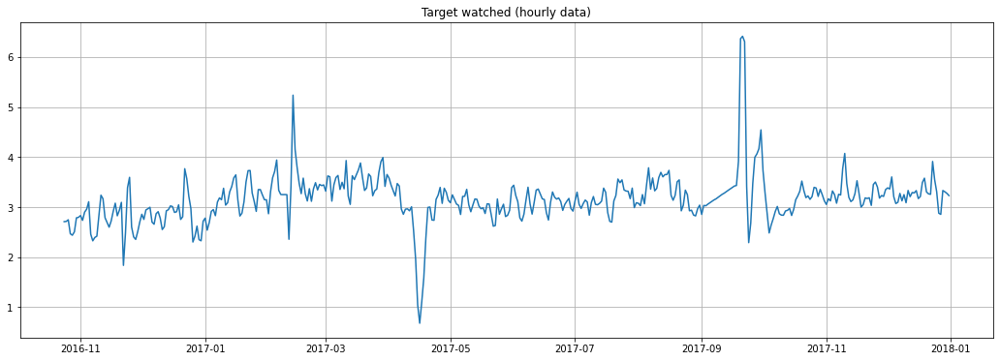

In [ ]:
# посмотрим на график целевой переменной
plt.figure(figsize=(18, 6))
plt.plot(target.target)
plt.title('Target watched (hourly data)')
plt.grid(True)
plt.show()

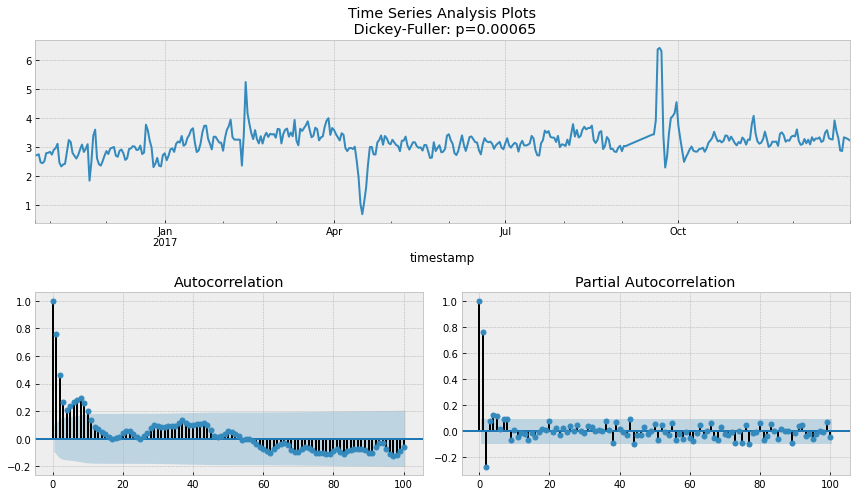

In [ ]:
# Построим график временных рядов, его ACF и PACF, рассчитаем тест Дикки–Фуллера
tsplot(target.target, lags=100)

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



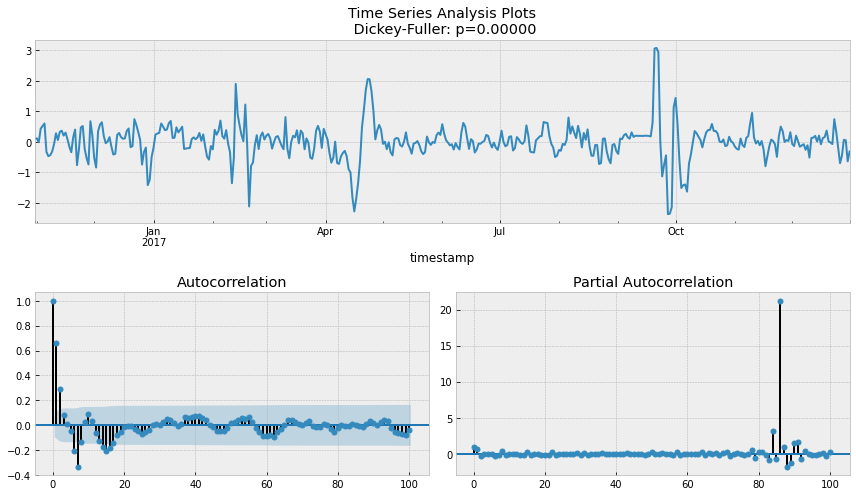

In [ ]:
# сезонная разница
target_diff = target.target - target.target.shift(7)
tsplot(target_diff[7:], lags=100)

/usr/local/lib/python3.7/dist-packages/statsmodels/regression/linear_model.py:1358: RuntimeWarning:

invalid value encountered in sqrt



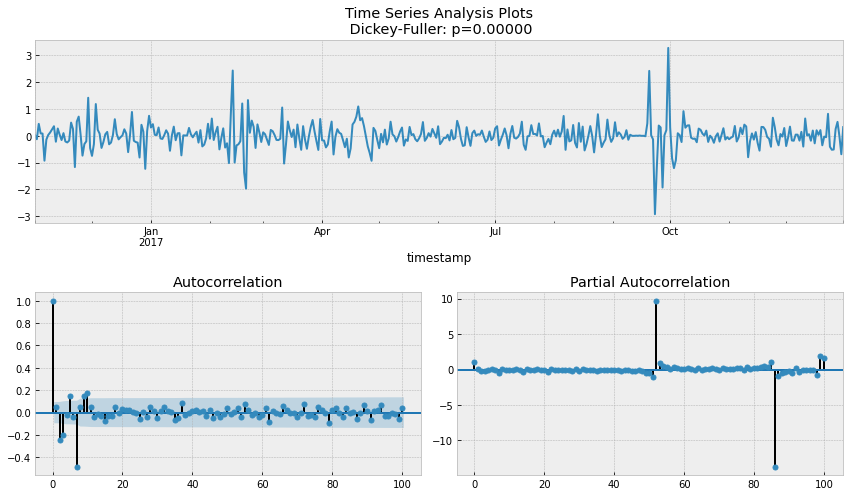

In [ ]:
# снава постороим графики без влияния сезонов
target_diff = target_diff - target_diff.shift(1)
tsplot(target_diff[7+1:], lags=100)

In [ ]:
# инициализируем группы параметров для подстановки
ps = range(1, 5)
d=2 
qs = range(1, 5)
Ps = range(0, 2)
D=1 # D равно 1, потому что мы учитываем сезонную разницу
Qs = range(0, 2)
s = 7 # длина сезона 7

# создадим список со всеми возможными комбинациями параметров
parameters = product(ps, qs, Ps, Qs)
parameters_list = list(parameters)
len(parameters_list)

64

In [ ]:
def optimizeSARIMA(parameters_list, d, D, s):
    """Return dataframe with parameters and corresponding AIC
        
        parameters_list - list with (p, q, P, Q) tuples
        d - integration order in ARIMA model
        D - seasonal integration order 
        s - length of season
    """
    
    results = []
    best_aic = float("inf")

    for param in tqdm_notebook(parameters_list):
        # we need try-except because on some combinations model fails to converge
        try:
            model=sm.tsa.statespace.SARIMAX(target.target, order=(param[0], d, param[1]), 
                                            seasonal_order=(param[2], D, param[3], s)).fit(disp=-1)
        except:
            continue
        aic = model.aic
        # saving best model, AIC and parameters
        if aic < best_aic:
            best_model = model
            best_aic = aic
            best_param = param
        results.append([param, model.aic])

    result_table = pd.DataFrame(results)
    result_table.columns = ['parameters', 'aic']
    # sorting in ascending order, the lower AIC is - the better
    result_table = result_table.sort_values(by='aic', ascending=True).reset_index(drop=True)
    
    return result_table

In [ ]:
# выполним расчеты для всех комбинаций параметров
warnings.filterwarnings("ignore") 
result_table = optimizeSARIMA(parameters_list, d, D, s)

  0%|          | 0/64 [00:00<?, ?it/s]

In [ ]:
# установим параметры с наименьшим AIC
p, q, P, Q = result_table.parameters[0]

best_model=sm.tsa.statespace.SARIMAX(target.target, order=(p, d, q), 
                                        seasonal_order=(P, D, Q, s)).fit(disp=-1)
print(best_model.summary())

                                 Statespace Model Results                                
Dep. Variable:                            target   No. Observations:                  434
Model:             SARIMAX(4, 2, 4)x(0, 1, 1, 7)   Log Likelihood                -120.815
Date:                           Thu, 16 Sep 2021   AIC                            261.631
Time:                                   04:56:08   BIC                            302.152
Sample:                               10-24-2016   HQIC                           277.639
                                    - 12-31-2017                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1304      0.048      2.714      0.007       0.036       0.225
ar.L2         -0.5917      0.050    -11.936

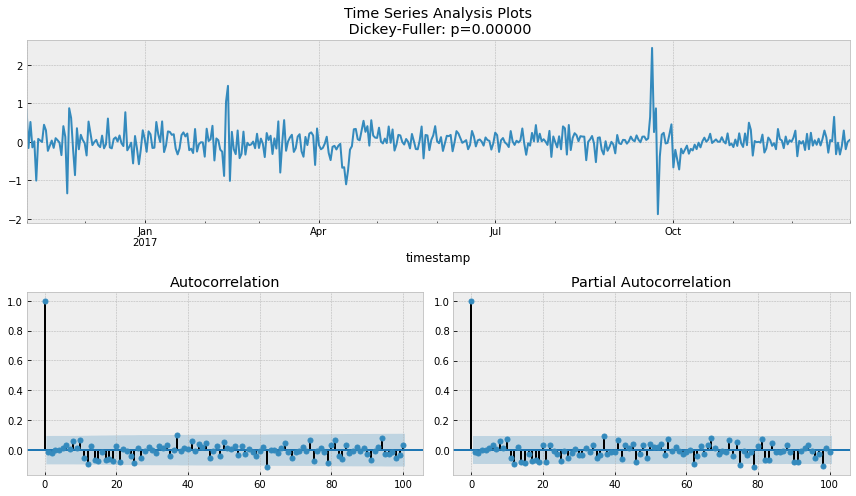

In [ ]:
# построим графики для модели с наилучшими параметрами
tsplot(best_model.resid[7+1:], lags=100)

In [ ]:
def plotSARIMA(series, model, n_steps):
    """Plots model vs predicted values
        
        series - dataset with timeseries
        model - fitted SARIMA model
        n_steps - number of steps to predict in the future    
    """
    
    # adding model values
    data = series.copy()
    data.columns = ['actual']
    data['sarima_model'] = model.fittedvalues
    # making a shift on s+d steps, because these values were unobserved by the model
    # due to the differentiating
    data['sarima_model'][:s+d] = np.NaN
    
    # forecasting on n_steps forward 
    forecast = model.predict(start = data.shape[0], end = data.shape[0]+n_steps)
    forecast = data.sarima_model.append(forecast)
    # calculate error, again having shifted on s+d steps from the beginning
    error = mean_absolute_percentage_error(data['actual'][s+d:], data['sarima_model'][s+d:])

    plt.figure(figsize=(15, 7))
    plt.title("Mean Absolute Percentage Error: {0:.2f}%".format(error))
    plt.plot(forecast, color='r', label="model")
    plt.axvspan(data.index[-1], forecast.index[-1], alpha=0.5, color='lightgrey')
    plt.plot(data.actual, label="actual")
    plt.legend()
    plt.grid(True)

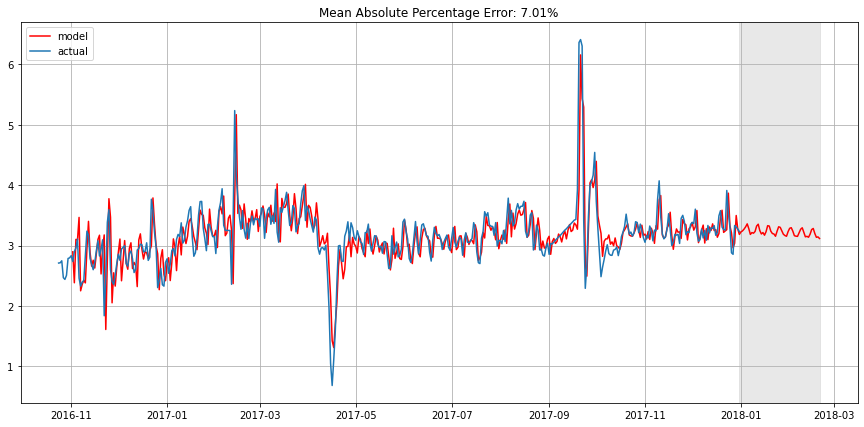

In [ ]:
# наложим графики целевой переменной и предсказания друг на друга
plotSARIMA(target, best_model, 50)

In [ ]:
# объединим данные
data = data_x.join(data_y.set_index('timestamp'), on='timestamp')
data.head(3)

,timestamp,f_0,f_1,f_2,f_3,f_4,f_5,f_6,f_7,f_8,f_9,f_10,f_11,f_12,f_13,f_14,f_15,f_16,f_17,f_18,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30,f_31,f_32,f_33,f_34,f_35,f_36,f_37,f_38,f_39,f_40,f_41,f_42,f_43,f_44,f_45,f_46,f_47,target
0,2016-10-24 16:00:00,NaN,NaN,NaN,-0.005383,6.251910,0.022304,1.466704,11.173872,236232.328494,239141.739468,236047.718208,10388.134152,10301.147575,10514.105249,45.330807,114.308237,130.949307,41.057286,105.973865,129.767924,643.938028,641.805951,37.864843,105.766633,131.088479,647.015112,33.219880,105.078138,629.911638,630.898807,620.607633,641.471009,119.665939,9.468025,8.720790,9.491729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10518.438958,235581.702442,10271.912950,1.718926,64589.460605,2.714220
1,2016-10-24 17:00:00,NaN,NaN,NaN,0.103383,6.465077,0.011693,1.267009,12.987551,236736.358537,237598.686177,234667.198152,10342.275453,10243.497056,10522.399442,45.346491,113.573405,131.134979,40.879320,106.376817,131.056496,645.646962,644.467521,37.998703,107.147223,131.258352,646.445612,32.923039,108.432319,630.888662,631.148243,617.627299,649.892132,120.168816,9.492814,8.672949,9.442881,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10529.380416,236303.564486,10185.329909,18.454216,64736.370856,2.709524
2,2016-10-24 18:00:00,NaN,NaN,NaN,-0.004852,6.315273,-0.003072,1.216848,12.824779,235780.400580,238313.969270,236595.519278,10311.392170,10295.566635,10545.026172,42.496189,113.960934,130.360285,40.834278,105.843890,130.375261,644.225458,643.544517,37.934885,107.696556,130.797973,647.069870,33.152057,106.901200,626.594563,631.062718,618.326995,636.883422,120.237631,9.501467,8.754266,9.406755,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10472.545087,237051.461382,10149.728277,5.764785,64638.208960,2.709705


In [ ]:
# добавим столбцы с различной привязкой к интервалам по времени
#data['dayofweek'] = data['timestamp'].apply(lambda x: x.dayofweek) # день недели !хуже на валидации
#data['dayornight'] = data['timestamp'].apply(lambda x: x.hour) # час суток !хуже везде

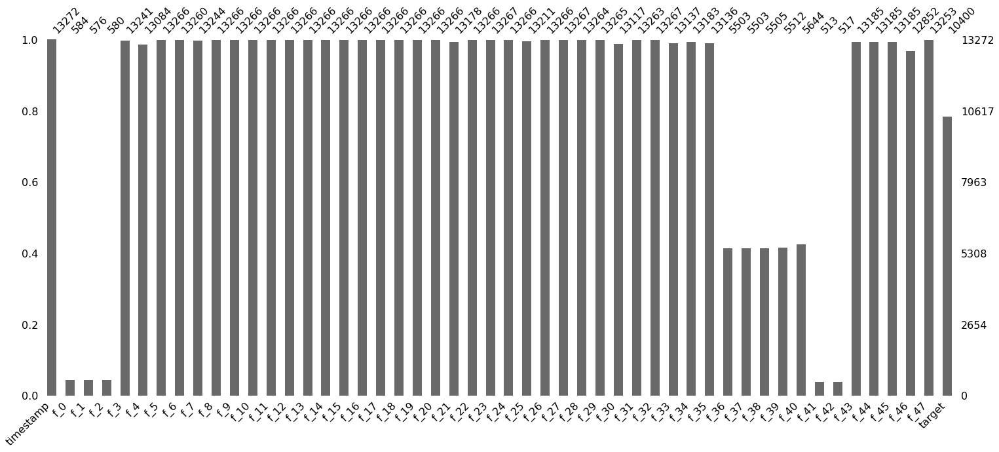

In [ ]:
# проверяем данные на пропущенные значения
msno.bar(data)

In [ ]:
# заменим пропущенные значения на медианные
for col in data.columns[1:]:
  data[col].fillna(data[col].median(), inplace=True)

In [ ]:
# Построим интерактивные графики параметров
l_graf = []
for col in data.columns[1:]:
    graf = alt.Chart(data[:5000]).mark_line(interpolate='step-after').encode(
        x='timestamp',
        y=col
    ).properties(
        width=800,
        height=350
    ).interactive(
        bind_y = False
    )
    l_graf.append(graf)
l_graf[48]#l_graf[1]|l_graf[2]|l_graf[3]+l_graf[4]+l_graf[5]+l_graf[6]+l_graf[7]+\
#l_graf[8]+l_graf[9]+l_graf[10]+l_graf[11]+l_graf[12]+l_graf[13]+l_graf[14]+l_graf[15]+\
#l_graf[16]+l_graf[17]+l_graf[18]+l_graf[19]+l_graf[20]+l_graf[21]+l_graf[22]+l_graf[23]+\
#l_graf[24]+l_graf[25]+l_graf[26]+l_graf[27]+l_graf[28]+l_graf[29]+l_graf[30]+l_graf[31]+\
#l_graf[32]+l_graf[33]+l_graf[34]+l_graf[35]+l_graf[36]+l_graf[37]+l_graf[38]+l_graf[39]+\
#l_graf[40]+l_graf[41]+l_graf[42]+l_graf[43]+l_graf[44]+l_graf[45]+l_graf[46]+l_graf[47]+l_graf[48]

alt.Chart(...)

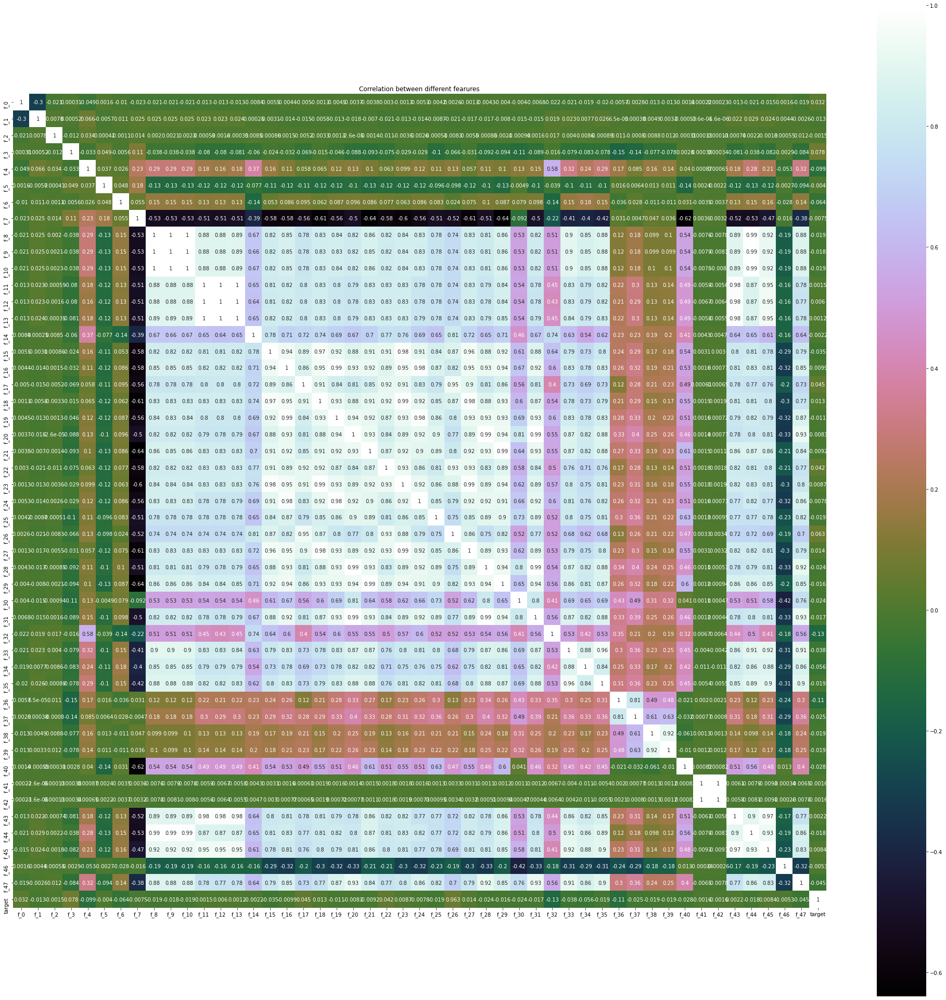

In [ ]:
# выполним попарную корреляцию
correlation = data.corr()
plt.figure(figsize=(35,35))
sns.heatmap(correlation, vmax=1, square=True,annot=True,cmap='cubehelix')

plt.title('Correlation between different fearures')
plt.show()

In [ ]:
# смотрим различные статистики
data.describe()

,f_0,f_1,f_2,f_3,f_4,f_5,f_6,f_7,f_8,f_9,f_10,f_11,f_12,f_13,f_14,f_15,f_16,f_17,f_18,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30,f_31,f_32,f_33,f_34,f_35,f_36,f_37,f_38,f_39,f_40,f_41,f_42,f_43,f_44,f_45,f_46,f_47,target
count,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000,13272.000000
mean,99.156470,0.241521,26.595233,0.070160,2.045364,0.021917,0.380039,4.008485,217131.625199,218916.918422,216714.915289,9863.514835,9820.029968,10063.960993,48.406834,116.983077,127.141320,41.096841,105.402006,126.921574,635.436445,628.607934,40.618142,104.825162,126.793723,632.994211,38.246302,105.589367,620.470828,614.624002,610.841684,637.207836,98.629953,8.315918,8.298226,8.225977,49.189315,49.722237,49.062870,49.131071,0.720835,0.008208,0.007934,10052.044853,217419.104575,9719.832008,19.351060,58328.693478,3.158866
std,0.083216,0.021036,0.527061,1.293564,2.064479,0.259452,0.800026,8.521850,34940.730962,35219.727151,34841.846322,1762.227193,1761.968895,1792.069592,10.190531,18.933269,20.762939,7.130971,16.629775,21.434559,45.025306,94.280982,6.833505,16.780531,21.213639,86.812082,6.920149,17.072962,42.070551,92.547972,32.624648,45.528963,27.075733,1.654878,1.756737,1.622090,3.239723,2.922349,4.795933,4.864877,0.062356,0.511033,0.357282,1773.567084,35242.300433,1819.413418,196.239788,12336.676219,0.448119
min,92.756623,0.003901,0.454774,-0.049504,-0.098147,-0.081726,-0.155299,-13.312292,-2000.516934,-1820.834828,-2207.501108,-163.873745,-166.952597,-158.217016,-10.054177,-1.090329,-1.592890,-0.472611,-0.417572,-1.787298,393.556898,2.123765,-0.286598,-2.201357,-0.916256,2.351833,-0.278215,-7.027282,385.602890,2.227581,389.912767,379.814331,-1.025175,-0.073680,-0.062344,-0.076208,-0.195410,-0.134301,-0.288237,-0.288872,0.069926,-0.100009,-0.056915,-94.490772,-1873.924198,-88.228769,-7.004686,-606.554446,0.641468
25%,99.158553,0.241518,26.602598,-0.007709,0.411158,-0.013148,0.002766,-0.013391,210148.929601,211800.867445,209803.074896,9801.166008,9755.282639,9985.175253,43.967609,117.046041,130.643019,41.404163,106.270564,130.561354,643.847646,644.645748,41.786199,106.142995,130.461135,647.482392,35.113365,106.535932,625.748265,630.466523,614.560197,642.687418,79.657239,8.125584,8.046174,8.054238,49.924561,49.983759,49.939684,49.953048,0.726490,0.003632,0.004704,9979.753994,210445.135598,9522.579747,2.775963,57346.882353,3.000579
50%,99.158553,0.241518,26.602598,0.000680,0.961050,0.002237,0.094131,3.122854,227941.698759,229874.679636,227436.422343,10346.360944,10306.487213,10556.156073,49.168324,119.796950,130.999092,41.975325,108.834737,130.961786,644.705570,646.092476,41.998676,107.836862,130.890030,648.471827,40.878640,108.505452,628.630718,631.935049,616.189482,646.335464,115.426972,8.701570,8.726090,8.557050,49.924561,49.983759,49.939684,49.953048,0.726490,0.003632,0.004704,10546.635177,228430.172772,10335.696771,5.361705,61539.523236,3.158355
75%,99.158553,0.241518,26.602598,0.009746,4.037037,0.018846,0.707255,6.403260,234715.736629,236652.055401,234236.194083,10498.930686,10446.497038,10719.244817,54.982764,122.603163,131.339491,42.268615,109.127796,131.351876,645.504758,647.401973,43.758118,109.057415,131.204623,649.401747,41.159454,110.260795,631.552526,633.132190,617.697395,649.600111,119.757182,9.059443,9.135519,8.928623,49.924561,49.983759,49.939684,49.953048,0.726490,0.003632,0.004704,10703.646715,235057.644257,10507.054871,8.420343,63960.682725,3.29

In [4]:
# воспользовавшись библиотекой tsfresh, на основе минимального набора параметров
# для извлечения признаков, создадим более расширенный, но пригодный для больших датасетов
#settings_time = settings.MinimalFCParameters
#settings_time.update(settings_minimal)
#settings_time

tsfresh.feature_extraction.settings.MinimalFCParameters

In [ ]:
# коэффициенты skewness и kurtosis, считается, сколько раз повторялось значение
# минимума и максимума, различные квантили, оконные статистики, автокорреляции
# и многое-многое другое
settings_efficient = settings.EfficientFCParameters()
len(settings_efficient)

72

In [ ]:
# самый большой и полный набор
settings_comprehensive = settings.ComprehensiveFCParameters()
len(settings_comprehensive)

74

In [ ]:
# преобразуем датасет в лонг формат
data_long = pd.DataFrame({0: data.loc[:, data.columns != 'timestamp'].values.flatten(),
                          1: np.arange(data.loc[:, data.columns != 'timestamp'].shape[0]).repeat(data.loc[:, data.columns != 'timestamp'].shape[1])})
print(data_long.shape)
data_long.head()

(650328, 2)


,0,1
0,99.158553,0
1,0.241518,0
2,26.602598,0
3,-0.005383,0
4,6.251910,0


In [ ]:
X = extract_features(data_long, column_id=1,
                     impute_function=impute, # функция для автоматического заполнения пропусков
                     default_fc_parameters=settings_efficient)
print(X.shape)

Feature Extraction: 100%|██████████| 5/5 [52:44<00:00, 632.80s/it]


(13272, 781)


In [ ]:
# готовим данные для регрессора
#X = data.drop(['timestamp', 'target'], axis=1)
y = data.target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=17) # разделяем данные на тренировочные и валидационные
#timeseries_train_test_split = TimeSeriesSplit(n_splits=5)
#X_train = timeseries_train_test_split.split(X) # разделяем данные на тренировочные и валидационные

In [ ]:
# создаем классификатор LassoCV#LinearRegression, обучаем, оцениваем точность
reg = linear_model.LinearRegression()
reg = reg.fit(X_train, y_train)
reg_score = mean_squared_error(y_test, reg.predict(X_test))
reg_score
# первоначально LinearRegression 0.1724105127835776
# с извлчением признаков и LinearRegression - 0.02749069585308945

0.02749069585308945

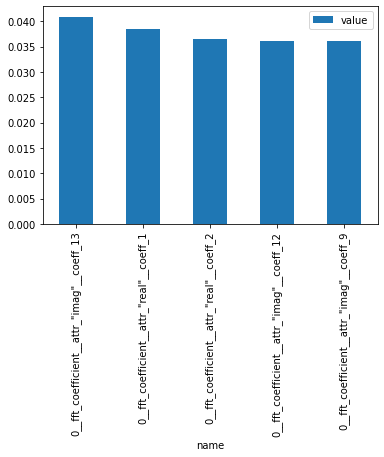

In [ ]:
# посмотрим наболее значимые положительные коэффициенты
df = pd.DataFrame(columns=['name', 'value'])
df.name = pd.Series(X.columns)
df.value = pd.Series(reg.coef_)
df = df[df.value!=0] # удалим нулевые коэффициенты
df_posit = df.sort_values(by='value', ascending=False).head()
df_posit.plot.bar(x='name')

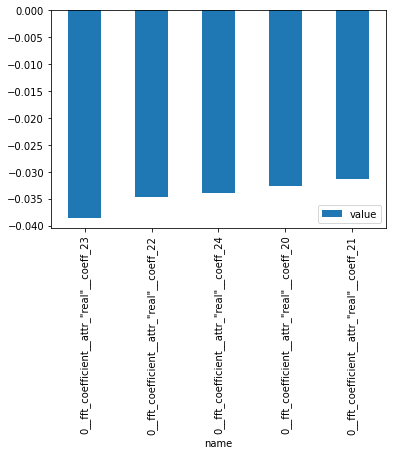

In [ ]:
# посмотрим наболее значимые негативные коэффициенты
df_neg = df.sort_values(by='value', ascending=True).head()
df_neg.plot.bar(x='name')

In [ ]:
# добавим стобцев предсказаний
pred = reg.predict(X)
data['predict'] = pred

In [ ]:
# Построим графики целевой переменной и предсказания
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['target'],
                    mode='lines',
                    name='target'))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['predict'],
                    mode='lines',
                    name='predict'))

fig.show()

In [ ]:
# все графики
fig = go.Figure()
for col in data.columns[1:]:
  fig.add_trace(go.Scatter(x=data['timestamp'], y=data[col],
                    mode='lines',
                    name=col))

fig.show()

In [ ]:
# загрузим базовое решение
base_target = pd.read_csv('baseline_coke.csv', parse_dates=['timestamp'])

In [ ]:
# посмотрим
base_target.head(3)

,timestamp,target
0,2018-01-01 00:00:00,3.126920
1,2018-01-01 01:00:00,3.126898
2,2018-01-01 02:00:00,3.126875


In [ ]:
# преобразуем датасет в лонг формат
data_long_base = pd.DataFrame({0: data[data['timestamp']>='2018-01-01 00:00:00'].drop(['timestamp', 'predict'], axis=1).values.flatten(),
                          1: np.arange(data[data['timestamp']>='2018-01-01 00:00:00'].drop(['timestamp', 'target', 'predict'], axis=1).shape[0])\
                          .repeat(data[data['timestamp']>='2018-01-01 00:00:00'].drop(['timestamp', 'predict'], axis=1).shape[1])})

X_base = extract_features(data_long_base, column_id=1,
                     impute_function=impute, # функция для автоматического заполнения пропусков
                     default_fc_parameters=settings_efficient)

Feature Extraction: 100%|██████████| 5/5 [05:38<00:00, 67.79s/it]


In [ ]:
reg.predict(X_base)

array([3.17606753, 3.18371407, 3.20796212, ..., 3.11171445, 3.117037  ,
       3.18733336])

In [ ]:
# ошибка по сравнению с базовым решением
mean_squared_error(base_target.target, reg.predict(X_base))
# первоначально LinearRegression 0.013426659152897468
# с извлчением признаков и LinearRegression - 0.006101669509144662

0.006101669509144662

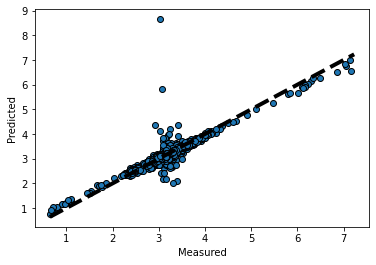

In [ ]:
# cross_val_predict returns an array of the same size as `y` where each entry
# is a prediction obtained by cross validation:
predicted = reg.predict(X_test)#cross_val_predict(lr, X, y, cv=5)

fig, ax = plt.subplots()
ax.scatter(y_test, predicted, edgecolors=(0, 0, 0))
ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
ax.set_xlabel('Measured')
ax.set_ylabel('Predicted')
plt.show()